# Texture visualization

This is a notebook to generate the figures in the paper that show off the output textures.

In [5]:
import matplotlib.pyplot as plt
from matplotlib.font_manager import fontManager
import torch
import mitsuba as mi
from pathlib import Path
from pyexr import read, write

from svbrdf_uncertainty.util import render_texture
from svbrdf_uncertainty.util.nvdiffrast import read_mesh

mi.set_variant('cuda_ad_rgb')
device = 'cuda' if 'cuda' in mi.variant() else 'cpu'

plt.rcParams["font.family"] = 'Linux Libertine O'
plt.rcParams["font.size"] = 30

red = '#F15E46'
blue = '#3DAEE3'
purple = '#8842eb'
grey = '#BBBBBB'

def get_square_bbox(mask, padding=0):
    """
    Compute square bounding box coordinates from a binary mask tensor.

    Args:
        mask (torch.Tensor): Binary mask tensor of shape (H, W) or (1, H, W)

    Returns:
        tuple: (x1, y1, x2, y2) coordinates of the square bounding box
    """
    # Ensure mask is 2D
    if mask.dim() == 3:
        mask = mask.squeeze(0)

    # Get indices of non-zero elements
    y_indices, x_indices = torch.where(mask)

    if len(y_indices) == 0:
        return None  # Return None if mask is empty

    # Find min/max coordinates
    x1, x2 = x_indices.min().item(), x_indices.max().item()
    y1, y2 = y_indices.min().item(), y_indices.max().item()

    # Calculate width and height
    width = x2 - x1
    height = y2 - y1

    # Make bounding box square by taking larger dimension
    size = max(width, height) + padding * 2

    # Calculate center point
    center_x = (x1 + x2) // 2
    center_y = (y1 + y2) // 2

    # Calculate new square coordinates centered around the original center
    half_size = size // 2
    new_x1 = center_x - half_size
    new_y1 = center_y - half_size
    new_x2 = center_x + half_size
    new_y2 = center_y + half_size

    return (new_x1, new_y1, new_x2, new_y2)

## Optimization results + entropy on Stanford ORB

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


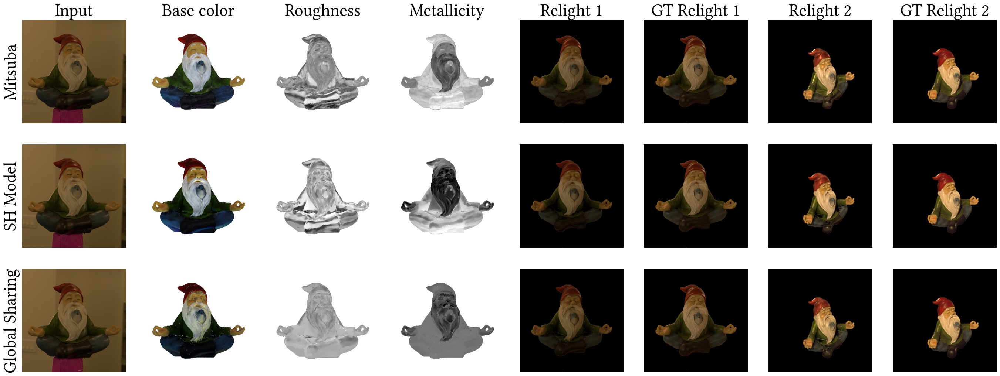

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

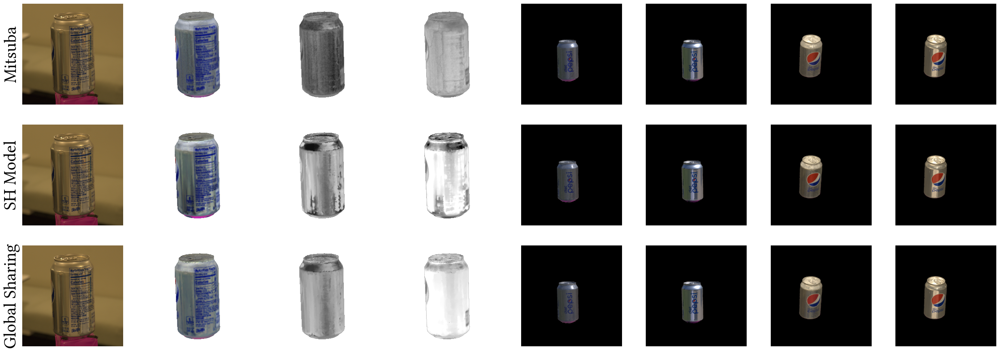

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


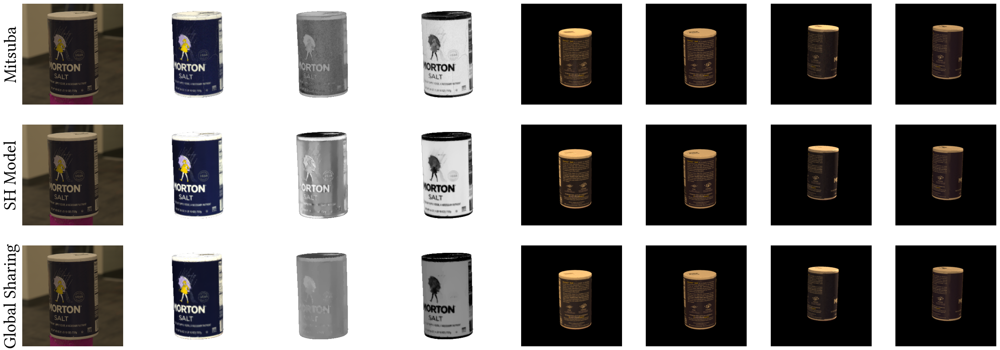

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping i

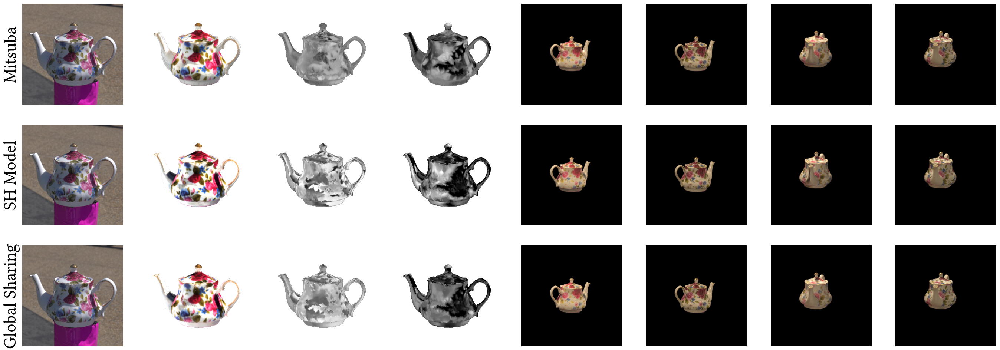

In [2]:
from svbrdf_uncertainty.datasets import StanfordORBDataset
from svbrdf_uncertainty.util.color import linear_to_gamma
from cv2 import imread
from skimage.transform import resize

dataset_path = '/local/home/rwiersma/Dev/Adobe/data/Stanford ORB'
out_path = Path('/local/home/rwiersma/Dev/Adobe/svbrdf_uncertainty/out/stanford_orb')
method_names = ['Mitsuba', 'SH Model', 'Global Sharing']
method_paths = ['mitsuba/baseline', 'sh/entropy_sigma', 'sh/entropy_global']
n_methods = len(method_names)

figure_path = Path('out/stanford_orb')
if not figure_path.exists(): figure_path.mkdir()

scenes = ['gnome_scene003', 'pepsi_scene003', 'salt_scene004', 'teapot_scene002']

def plot_stanford_orb_scene(scene, show_titles=False):
    dataset = StanfordORBDataset(dataset_path, scene, scale_factor=0.25)
    sensors = dataset.sensors
    sensor_idx = 0

    mesh_pos, mesh_faces, mesh_uv, _ = read_mesh(dataset.mesh)
    mesh_attributes = (mesh_pos, mesh_faces, mesh_uv)

    fig, axs = plt.subplots(n_methods, 8, figsize=(34, 4 * n_methods + show_titles * 0.4))
    for row in axs:
        for ax in row:
            ax.set_xticks([])
            ax.set_yticks([])
            ax.spines['top'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.spines['bottom'].set_visible(False)
            ax.spines['left'].set_visible(False)

    mask = render_texture(torch.ones((512, 512, 1), device=device), *mesh_attributes, sensors[sensor_idx])[..., 0].cpu()
    x1, y1, x2, y2 = get_square_bbox(mask, padding=20)
    mask = mask[y1:y2, x1:x2]

    if show_titles:
        axs[0][0].set_title('Input')
        axs[0][1].set_title('Base color')
        axs[0][2].set_title('Roughness')
        axs[0][3].set_title('Metallicity')
        axs[0][4].set_title('Relight 1')
        axs[0][5].set_title('GT Relight 1')
        axs[0][6].set_title('Relight 2')
        axs[0][7].set_title('GT Relight 2')

    for i in range(n_methods):
        roughness_pred = torch.Tensor(read(str(out_path / scene / method_paths[i] / 'roughness.exr'))).to(device)
        metallic_pred = torch.Tensor(read(str(out_path / scene / method_paths[i] / 'metallic.exr'))).to(device)
        base_color_pred = torch.Tensor(read(str(out_path / scene / method_paths[i] / 'base_color.exr'))).to(device)
        entropy = torch.Tensor(read(str(out_path / scene / method_paths[i] / 'entropy.exr'))).to(device)

        axs[i][0].set_ylabel(method_names[i], fontsize='large')
        axs[i][0].imshow(linear_to_gamma(dataset[sensor_idx]).cpu()[y1:y2, x1:x2])
        axs[i][1].imshow(render_texture(base_color_pred, *mesh_attributes, sensors[sensor_idx]).cpu()[y1:y2, x1:x2] * mask.unsqueeze(-1) + (torch.ones_like(mask) * (1 - mask)).unsqueeze(-1), vmin=0, vmax=1)
        axs[i][2].imshow(render_texture(roughness_pred, *mesh_attributes, sensors[sensor_idx]).cpu()[y1:y2, x1:x2], alpha=mask, cmap='gray', vmin=0, vmax=1)
        axs[i][3].imshow(render_texture(metallic_pred, *mesh_attributes, sensors[sensor_idx]).cpu()[y1:y2, x1:x2], alpha=mask, cmap='gray', vmin=0, vmax=1)

        relight_path = (out_path / scene / 'relighting' / method_paths[i])
        relight_folders = sorted([f.stem for f in relight_path.iterdir()])
        for relight_i, relight_folder in enumerate(relight_folders):
            if relight_i > 1: break

            relight_image_path = [f for f in (relight_path / relight_folder).iterdir()][5]
            relight_image = linear_to_gamma(torch.from_numpy(read(str(relight_image_path)))).numpy()
            cam_idx = relight_image_path.stem
            relight_scene = relight_image_path.parent.stem
            relight_mask_path = Path(dataset_path) / 'blender_HDR' / relight_scene / 'test_mask' / (cam_idx + '.png')
            relight_mask = resize(imread(relight_mask_path), (512, 512))
            relight_gt_path = Path(dataset_path) / 'blender_HDR' / relight_scene / 'test' / (cam_idx + '.exr')
            relight_gt = resize(linear_to_gamma(torch.from_numpy(read(str(relight_gt_path)))).numpy(), (512, 512))
            relight_image = relight_mask * relight_image 
            relight_gt = relight_mask * relight_gt
            axs[i][4 + relight_i * 2].imshow(relight_image)
            axs[i][5 + relight_i * 2].imshow(relight_gt)


    plt.savefig(figure_path / (scene + '.pdf'), format='pdf', bbox_inches='tight')
    plt.show()

show_titles = True
for scene in scenes:
    plot_stanford_orb_scene(scene, show_titles)
    show_titles=False

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


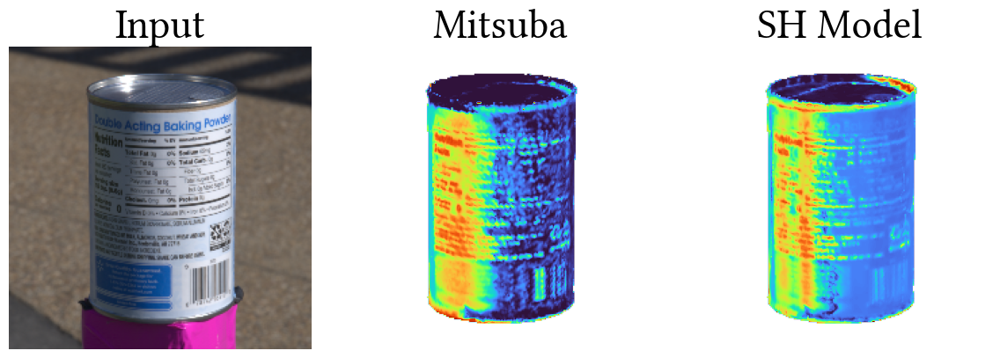

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


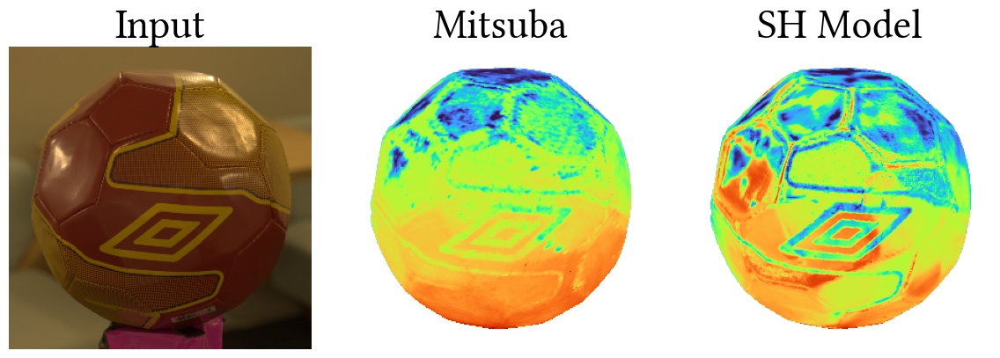

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


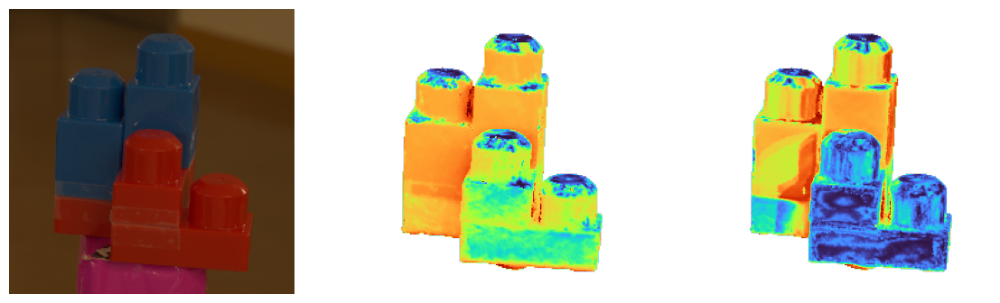

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


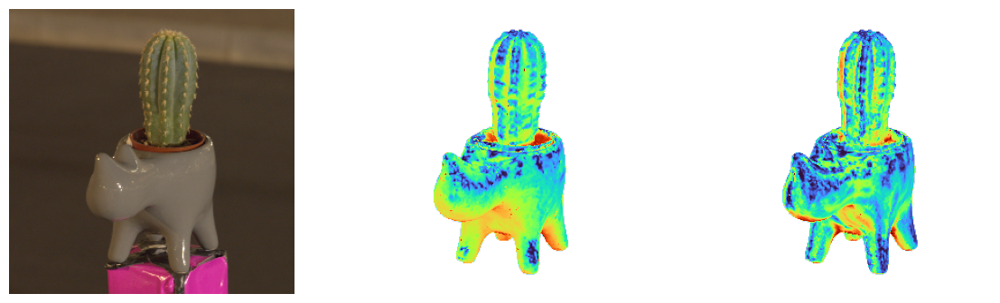

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


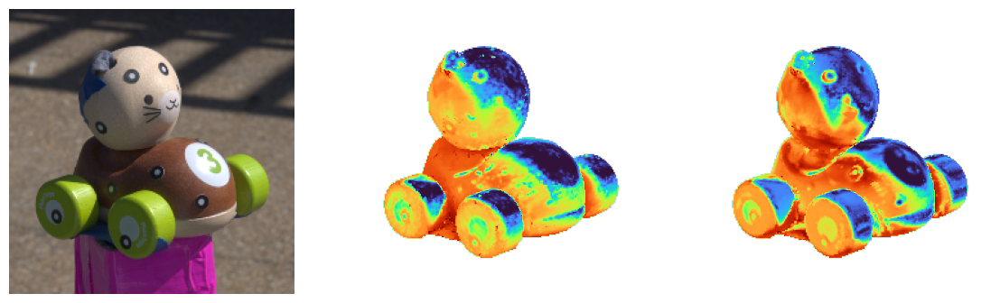

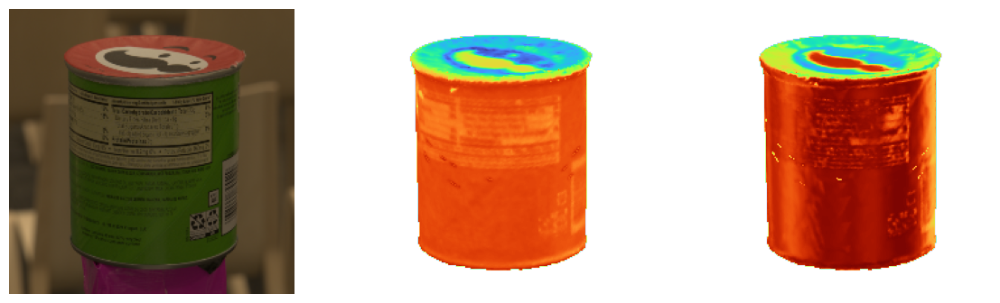

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


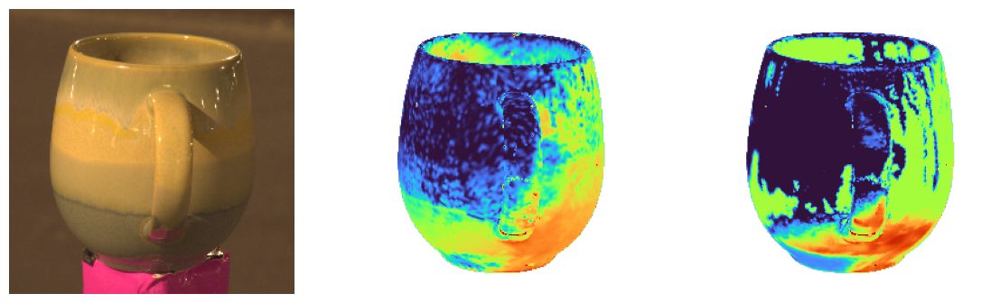

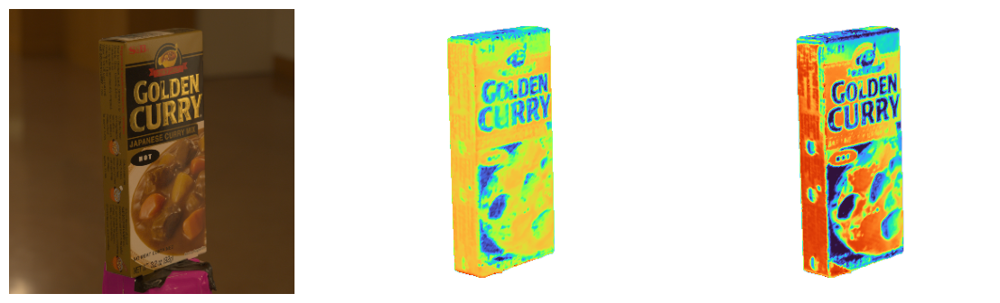

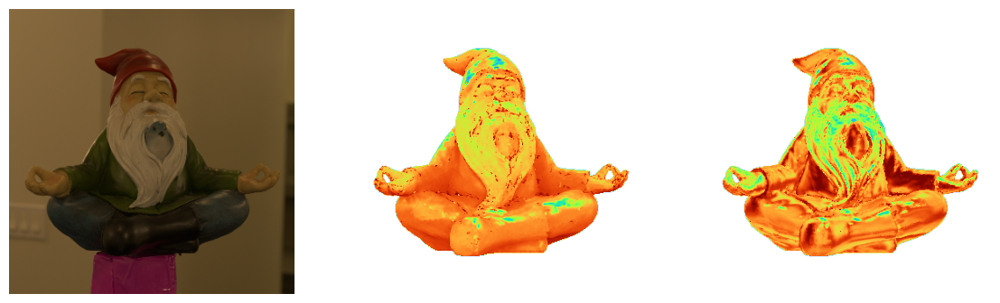

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


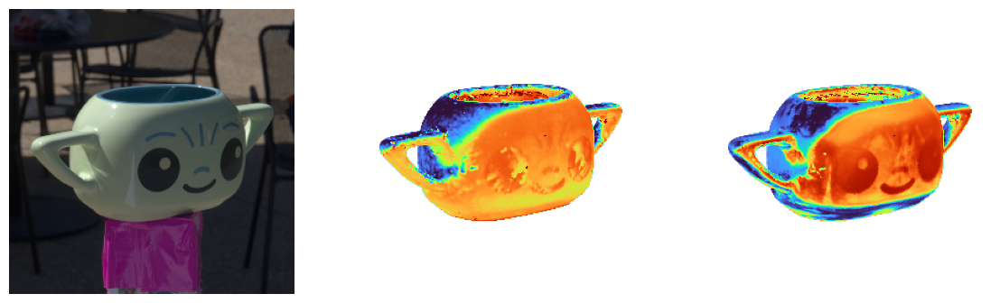

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


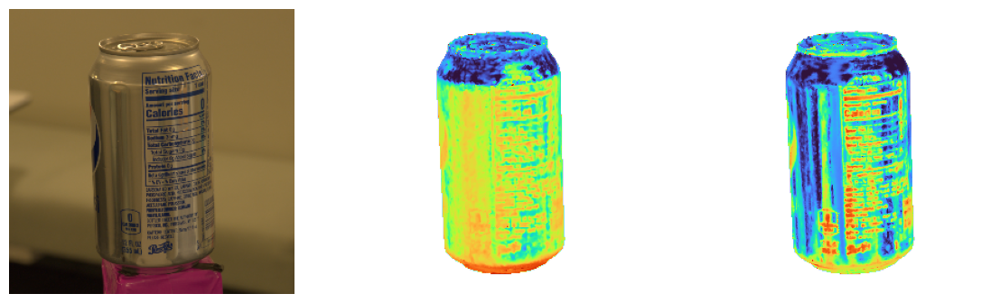

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


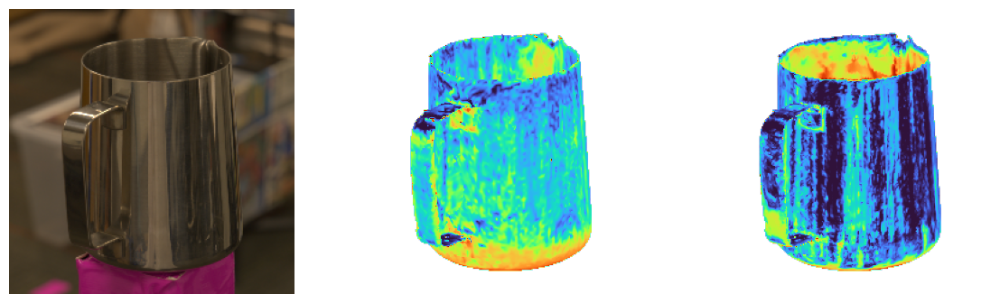

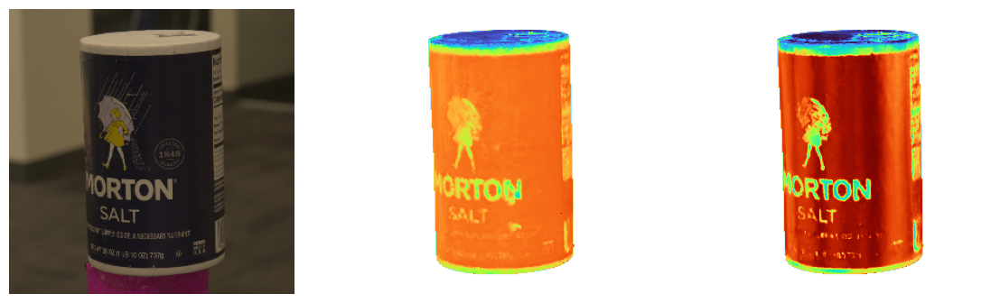

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


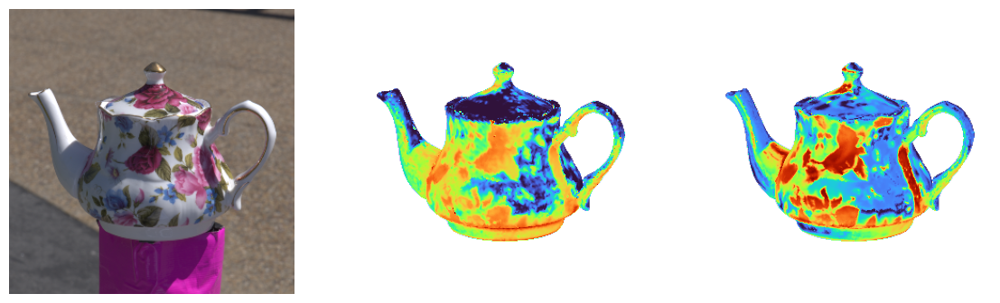

In [3]:
from svbrdf_uncertainty.datasets import StanfordORBDataset
from svbrdf_uncertainty.util.color import linear_to_gamma
from cv2 import imread
from skimage.transform import resize

dataset_path = '/local/home/rwiersma/Dev/Adobe/data/Stanford ORB'
out_path = Path('/local/home/rwiersma/Dev/Adobe/svbrdf_uncertainty/out/stanford_orb')
method_names = ['Mitsuba', 'SH Model']
method_paths = ['mitsuba/baseline', 'sh/entropy_sigma']
n_methods = len(method_names)

figure_path = Path('out/stanford_orb')
if not figure_path.exists(): figure_path.mkdir()

scenes = ['grogu_scene002', 'gnome_scene003', 'blocks_scene005', 'baking_scene002', 'ball_scene003', 'cactus_scene007', 'car_scene002', 'chips_scene004', 'cup_scene007', 'curry_scene005', 'pepsi_scene003', 'pitcher_scene001', 'salt_scene004', 'teapot_scene002']
scenes = sorted(scenes)

def plot_stanford_orb_entropy(scene, show_titles=False):
    dataset = StanfordORBDataset(dataset_path, scene, scale_factor=0.25)
    sensors = dataset.sensors
    sensor_idx = 0

    mesh_pos, mesh_faces, mesh_uv, _ = read_mesh(dataset.mesh)
    mesh_attributes = (mesh_pos, mesh_faces, mesh_uv)

    fig, axs = plt.subplots(1, 1 + n_methods, figsize=((1 + n_methods) * 4, 4 + show_titles * 0.4))
    for ax in axs:
        ax.set_xticks([])
        ax.set_yticks([])
        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

    mask = render_texture(torch.ones((512, 512, 1), device=device), *mesh_attributes, sensors[sensor_idx])[..., 0].cpu()
    (x1, y1, x2, y2) = get_square_bbox(mask, padding=20)

    if show_titles:
        axs[0].set_title('Input')
    axs[0].imshow(linear_to_gamma(dataset[sensor_idx]).cpu()[y1:y2, x1:x2])
    for i in range(n_methods):
        if show_titles:
            axs[1 + i].set_title(method_names[i])

        entropy = torch.Tensor(read(str(out_path / scene / method_paths[i] / 'entropy.exr'))).to(device)
        pcm = axs[1 + i].imshow(render_texture(entropy, *mesh_attributes, sensors[sensor_idx]).cpu()[y1:y2, x1:x2], alpha=mask[y1:y2, x1:x2], cmap='turbo', vmin=0, vmax=1)

    fig.tight_layout()

    plt.savefig(figure_path / (scene + '_entropy.pdf'), format='pdf', bbox_inches='tight')
    plt.show()

for i, scene in enumerate(scenes):
    plot_stanford_orb_entropy(scene, i < 2)

## Optimization results + entropy on Synthetic

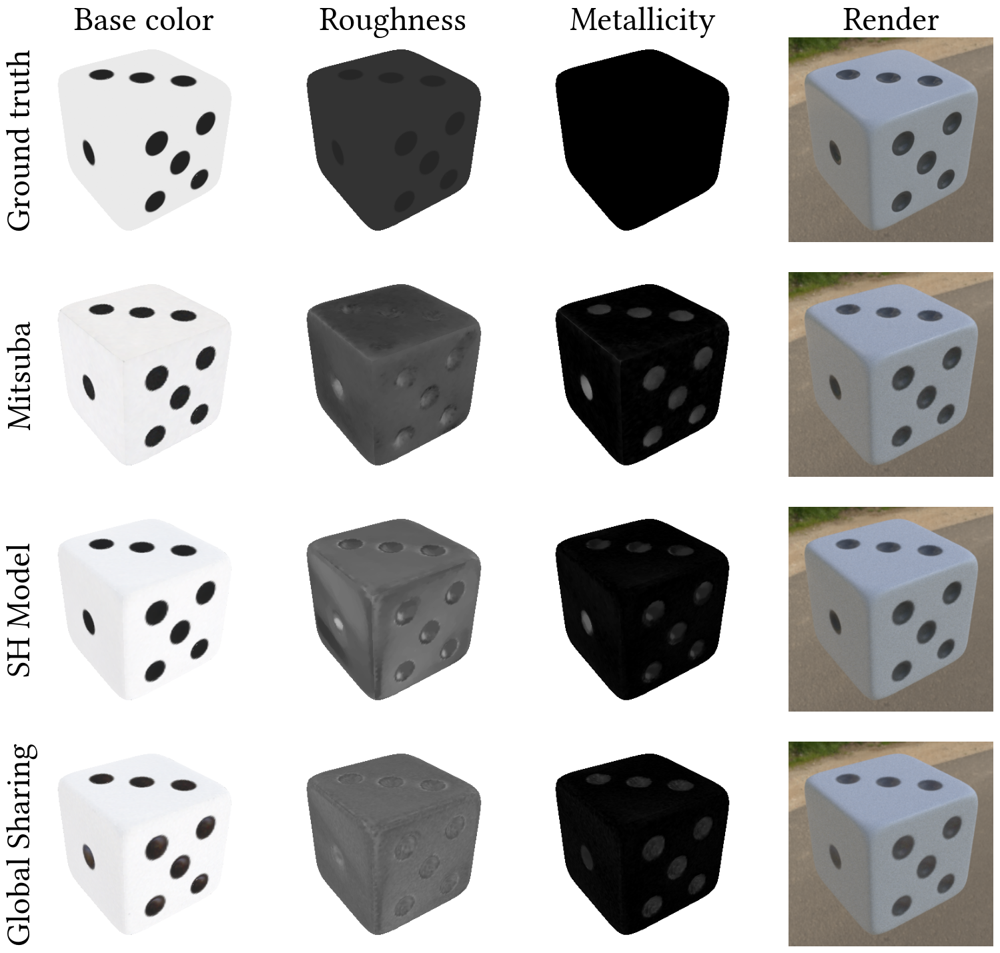

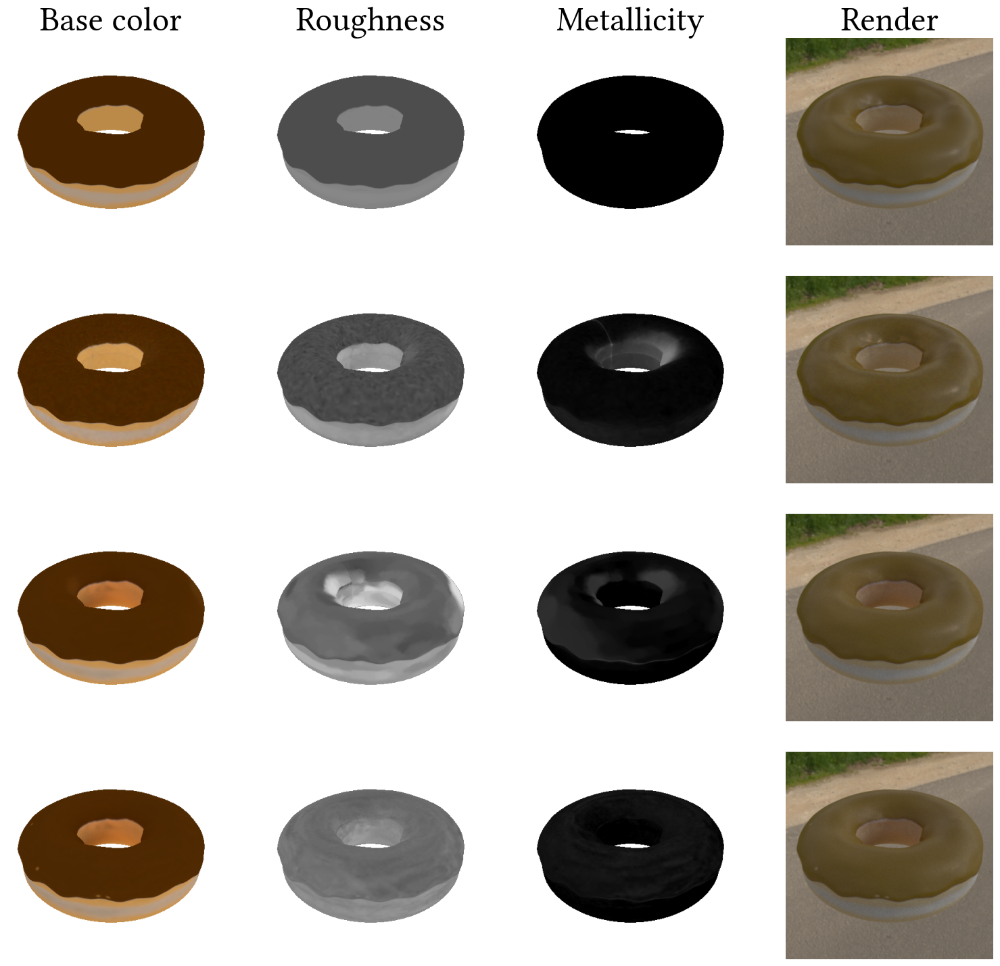

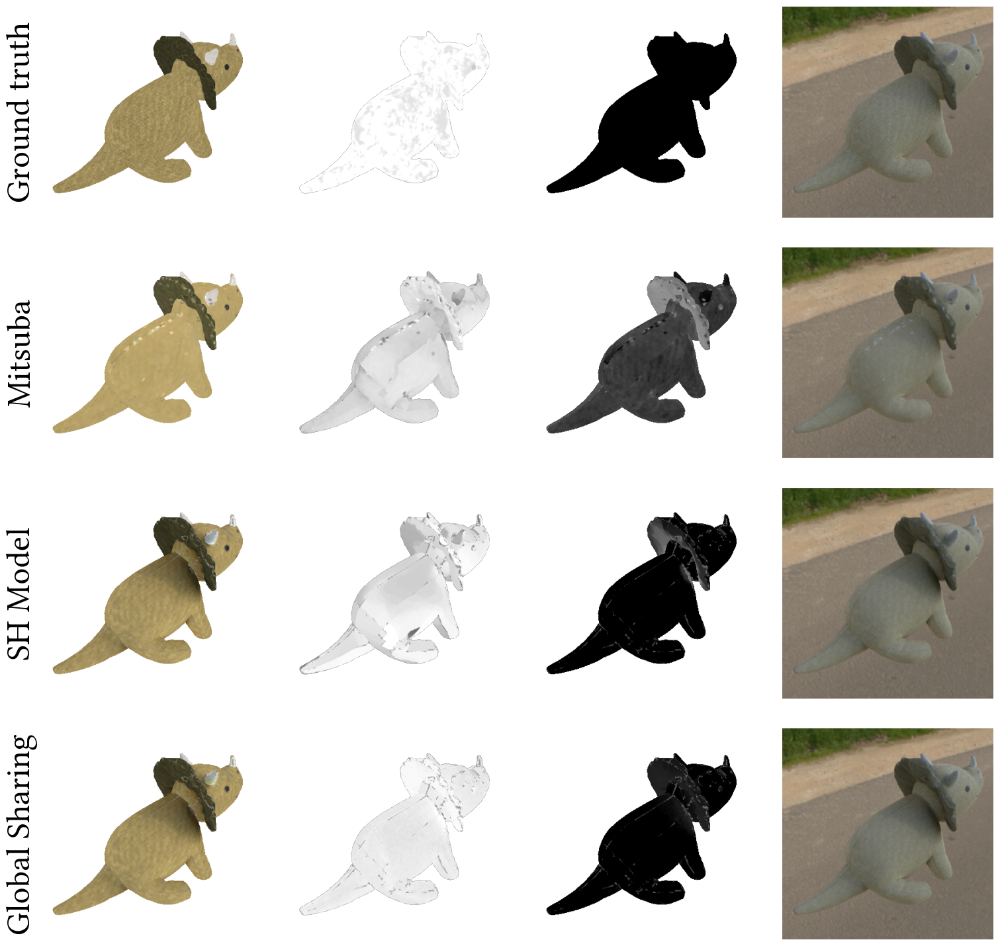

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


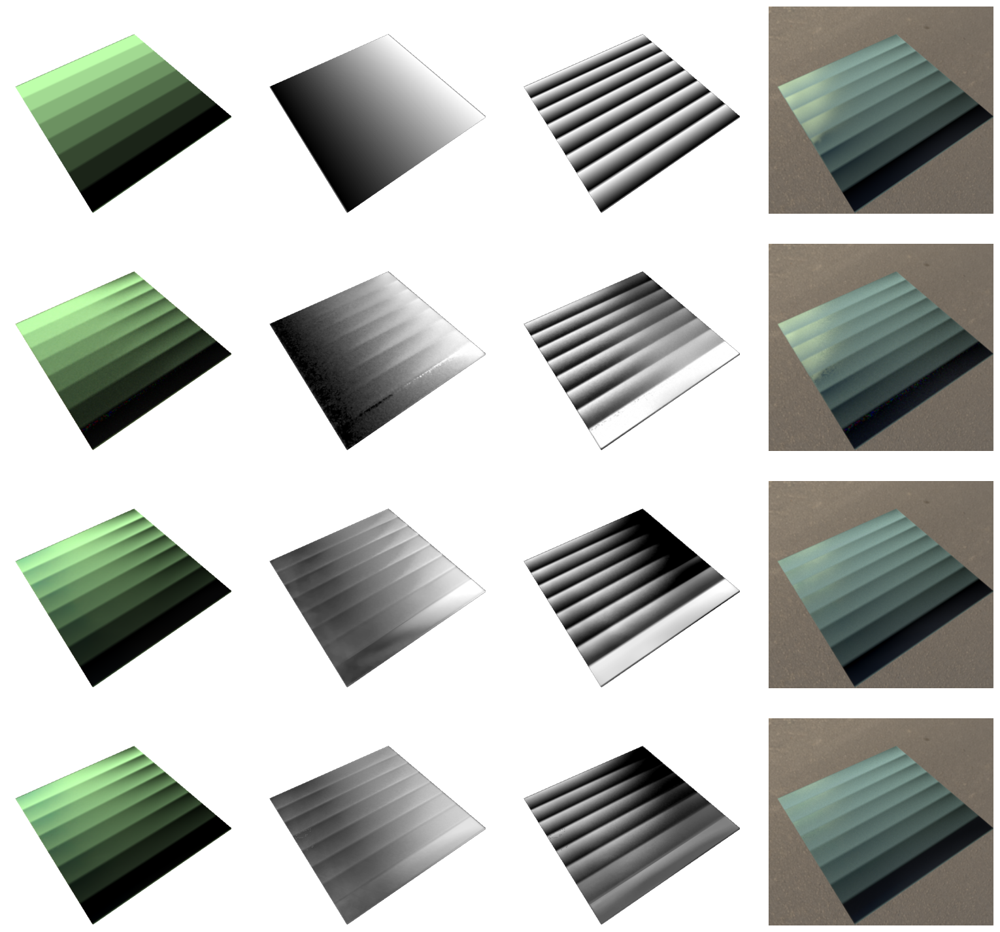

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


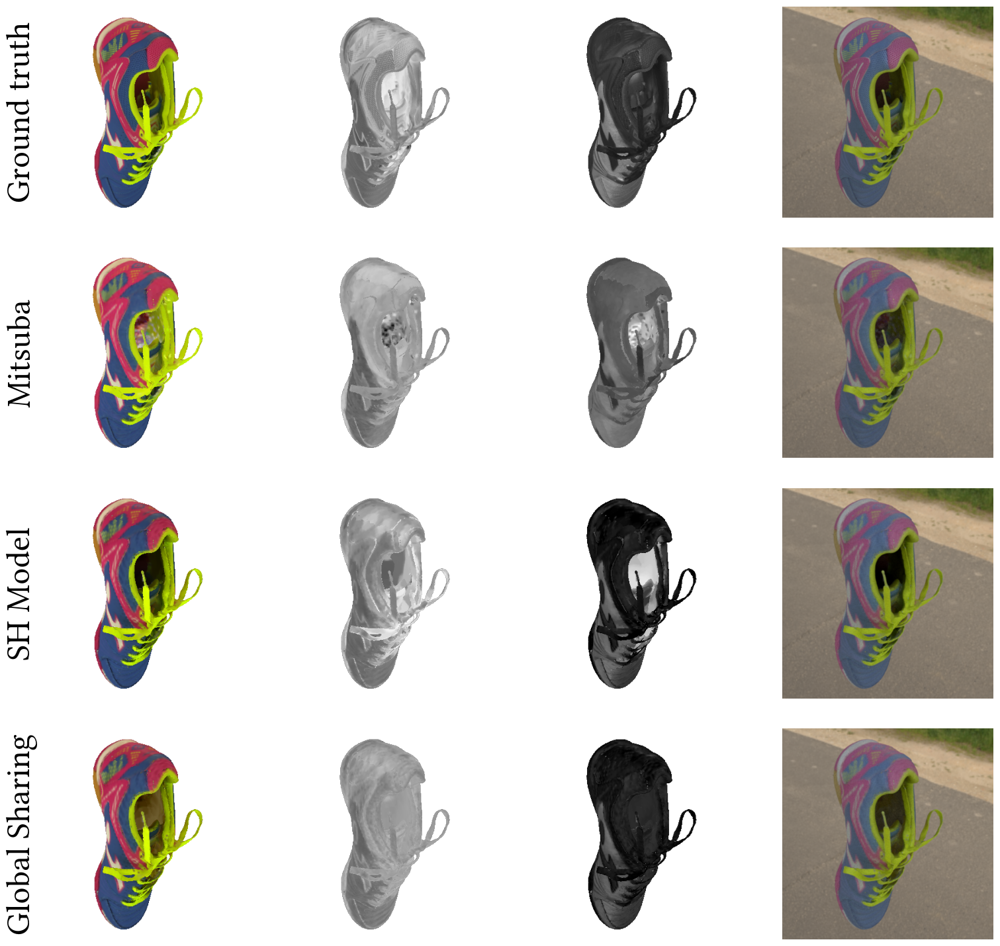

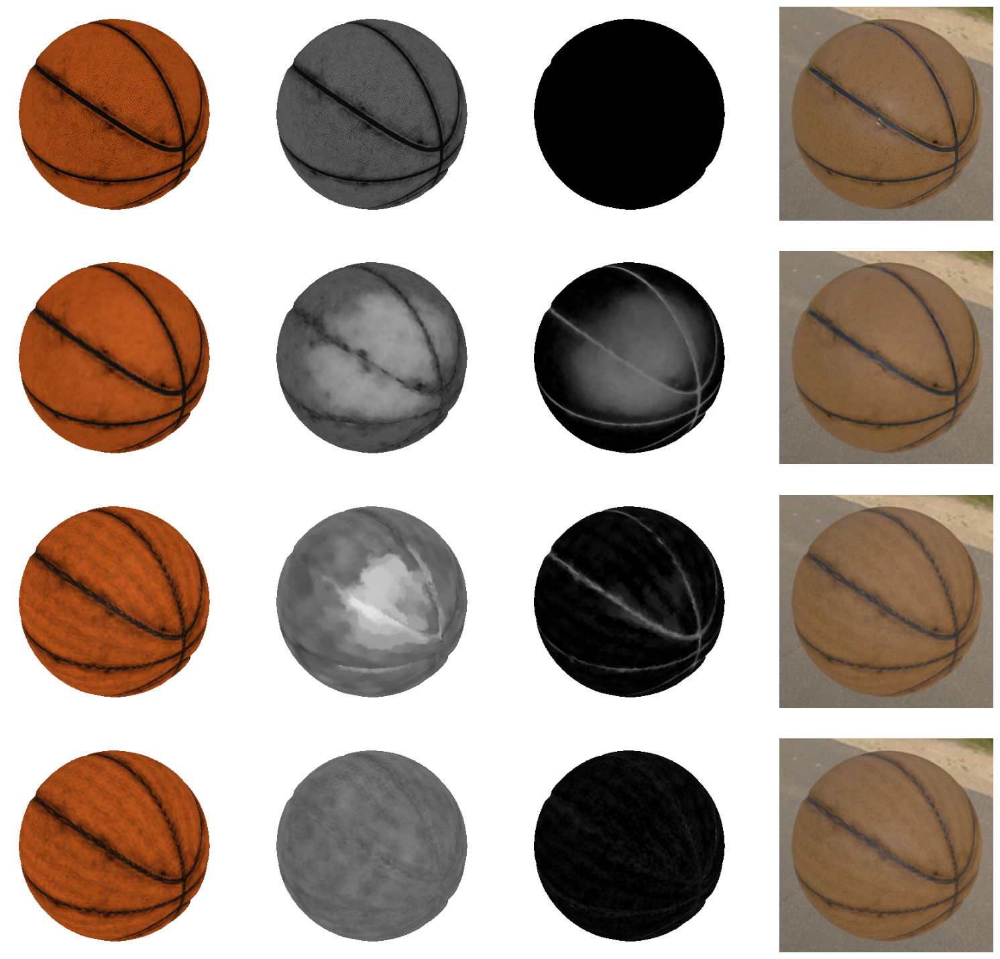

In [6]:
from svbrdf_uncertainty.datasets import SyntheticDataset
from svbrdf_uncertainty.util.color import linear_to_gamma_dr, linear_to_gamma
import gin

dataset_path = Path('/local/home/rwiersma/Dev/Adobe/data/synthetic_benchmark')
out_path = Path('/local/home/rwiersma/Dev/Adobe/svbrdf_uncertainty/out/synthetic_benchmark')
method_names = ['Mitsuba', 'SH Model', 'Global Sharing']
method_paths = ['mitsuba/baseline', 'sh/baseline', 'sh/entropy_global']
n_methods = len(method_names)

figure_path = Path('out/synthetic')
if not figure_path.exists(): figure_path.mkdir()

scenes = sorted([f.stem for f in dataset_path.iterdir() if (dataset_path / f).is_dir() and not f.match('envmaps')])
envmaps = sorted([f for f in (dataset_path / 'envmaps').iterdir() if f.match('*.exr')])

def plot_synthetic_scene(scene, envmap, sensor_idx=0, show_heading=False, show_labels=False):
    scene_folder = dataset_path / scene

    gin.parse_config_file(str(scene_folder / 'dataset.gin'))
    dataset = SyntheticDataset(str(scene_folder), envmap_path=str(envmap),
                                sensor_count=100, resolution=512, spp=256, views_subfolder=envmap.stem)
    sensors = dataset.sensors

    mesh_pos, mesh_faces, mesh_uv, _ = read_mesh(dataset.mesh)
    mesh_attributes = (mesh_pos, mesh_faces, mesh_uv)

    fig, axs = plt.subplots(n_methods + 1, 4, figsize=(16, 4 * (n_methods + 1) - 1.0))
    for row in axs:
        for ax in row:
            ax.set_xticks([])
            ax.set_yticks([])

            ax.spines['top'].set_visible(False)
            ax.spines['right'].set_visible(False)
            ax.spines['bottom'].set_visible(False)
            ax.spines['left'].set_visible(False)

    mask = render_texture(torch.ones((512, 512, 1), device=device), *mesh_attributes, sensors[sensor_idx])[..., 0].cpu()
    x1, y1, x2, y2 = get_square_bbox(mask, padding=20)
    mask = mask[y1:y2, x1:x2]

    if show_heading:
        axs[0][0].set_title('Base color')
        axs[0][1].set_title('Roughness')
        axs[0][2].set_title('Metallicity')
        axs[0][3].set_title('Render')

    axs[0][0].set_ylabel('Ground truth' if show_labels else '', fontsize='large')
    if scene == 'spot':
        dataset.base_color = resize(dataset.base_color, (512, 512))
        dataset.roughness = resize(dataset.roughness, (512, 512))
        dataset.metallic = resize(dataset.metallic, (512, 512))
    axs[0][0].imshow(render_texture(torch.tensor(dataset.base_color, device=device), *mesh_attributes, sensors[sensor_idx]).cpu()[y1:y2, x1:x2] * mask.unsqueeze(-1) + (torch.ones_like(mask) * (1 - mask)).unsqueeze(-1), vmin=0, vmax=1)
    axs[0][1].imshow(render_texture(torch.tensor(dataset.roughness, device=device)[..., None], *mesh_attributes, sensors[sensor_idx]).cpu()[y1:y2, x1:x2], alpha=mask, cmap='gray', vmin=0, vmax=1)
    axs[0][2].imshow(render_texture(torch.tensor(dataset.metallic, device=device)[..., None], *mesh_attributes, sensors[sensor_idx]).cpu()[y1:y2, x1:x2], alpha=mask, cmap='gray', vmin=0, vmax=1)
    axs[0][3].imshow(linear_to_gamma(dataset[sensor_idx]).cpu()[y1:y2, x1:x2])

    for i in range(n_methods):
        roughness_pred = torch.Tensor(read(str(out_path / scene / envmap.stem / method_paths[i] / 'roughness.exr'))).to(device)
        metallic_pred = torch.Tensor(read(str(out_path / scene / envmap.stem / method_paths[i] / 'metallic.exr'))).to(device)
        base_color_pred = torch.Tensor(read(str(out_path / scene / envmap.stem / method_paths[i] / 'base_color.exr'))).to(device)

        if show_labels:
            axs[1 + i][0].set_ylabel(method_names[i], fontsize='large')
        axs[1 + i][0].imshow(render_texture(base_color_pred, *mesh_attributes, sensors[sensor_idx]).cpu()[y1:y2, x1:x2] * mask.unsqueeze(-1) + (torch.ones_like(mask) * (1 - mask)).unsqueeze(-1), vmin=0, vmax=1)
        axs[1 + i][1].imshow(render_texture(roughness_pred, *mesh_attributes, sensors[sensor_idx]).cpu()[y1:y2, x1:x2], alpha=mask, cmap='gray', vmin=0, vmax=1)
        axs[1 + i][2].imshow(render_texture(metallic_pred, *mesh_attributes, sensors[sensor_idx]).cpu()[y1:y2, x1:x2], alpha=mask, cmap='gray', vmin=0, vmax=1)


        # Create material for Mitsuba
        material = {
            'type': 'principled',
            'eta': 1.5,
            'metallic': {
                'type': 'bitmap',
                'bitmap': mi.util.convert_to_bitmap(metallic_pred)
            },
            'base_color': {
                'type': 'bitmap',
                'bitmap': mi.util.convert_to_bitmap(base_color_pred)
            },
            'roughness': {
                'type': 'bitmap',
                'bitmap': mi.util.convert_to_bitmap(roughness_pred)
            }
        }
        mi_scene = dataset.get_scene(mesh=dataset.mesh, material=material, envmap_path=dataset.envmap_path)
        axs[1 + i][3].imshow(linear_to_gamma_dr(mi.render(mi_scene, sensor=dataset.sensors[sensor_idx], spp=128))[y1:y2, x1:x2])


    fig.tight_layout()

    plt.savefig(figure_path / (scene + '.pdf'), format='pdf', bbox_inches='tight')
    plt.show()

envmap = list(filter(lambda e: e.match(f'*rural*'), envmaps))[0]
scenes_select = ['dice', 'chocolate_donut', 'triceratops', 'plane', 'sneaker', 'basketball']
sensors = [22, 22, 22, 22, 20, 20]

for i, (scene, sensor_idx) in enumerate(zip(scenes_select, sensors)):
    plot_synthetic_scene(scene, envmap, sensor_idx=sensor_idx, show_heading=i < 2, show_labels=i % 2 == 0)

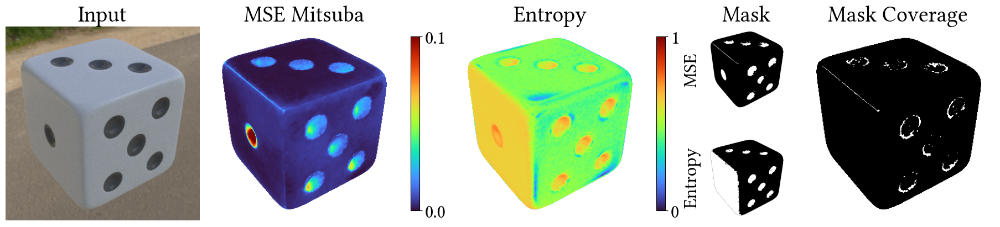

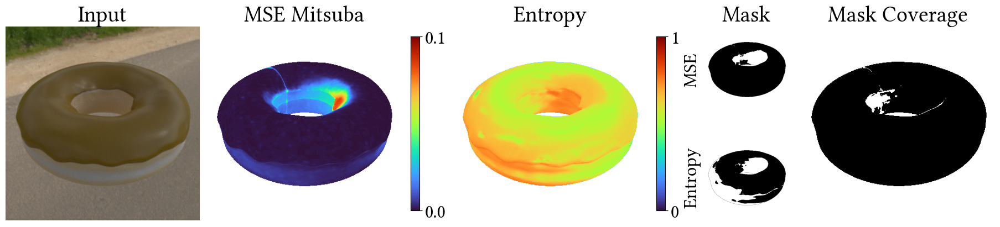

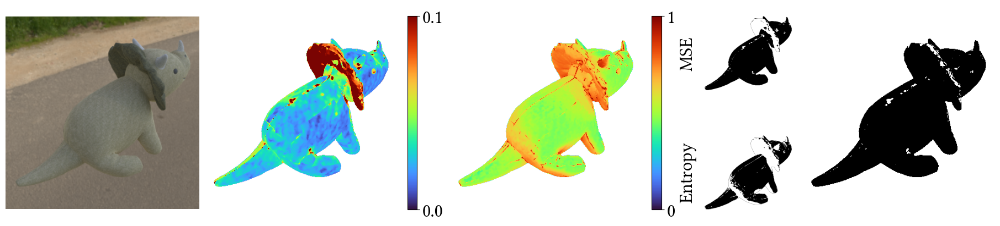

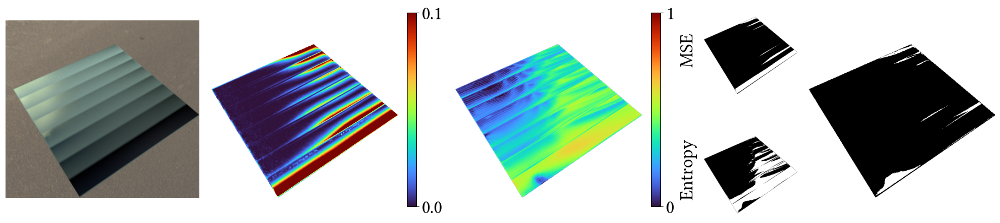

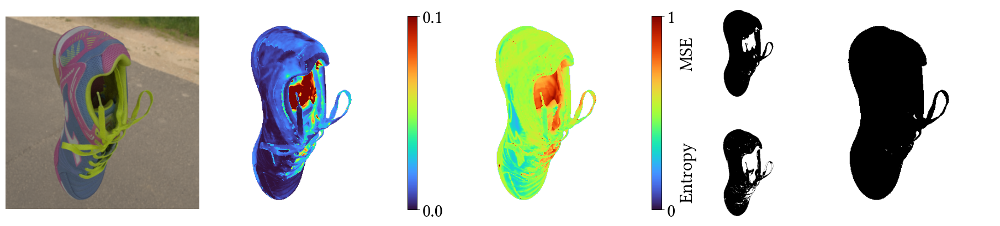

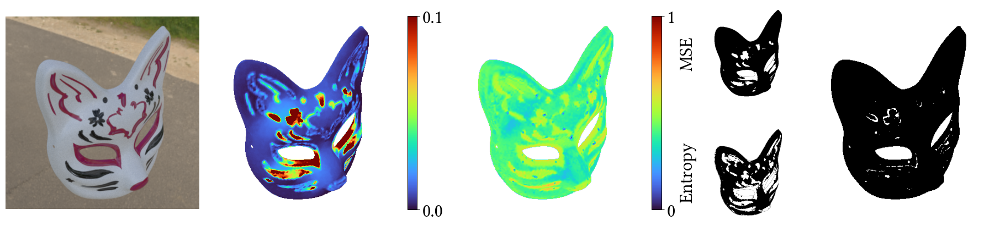

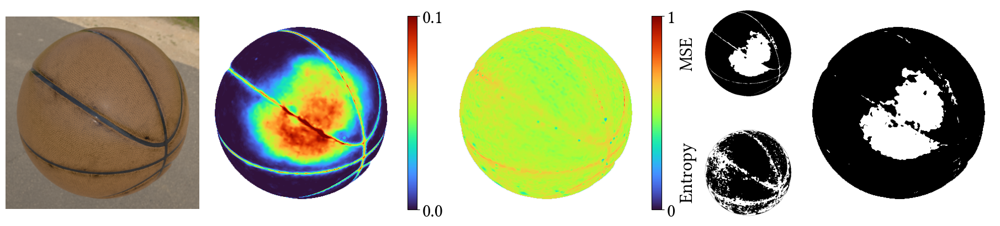

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


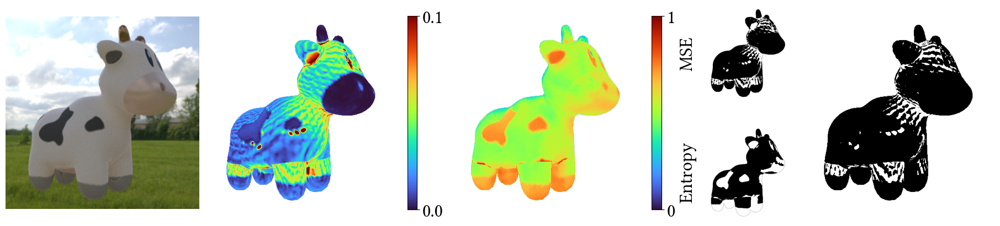

In [9]:
from svbrdf_uncertainty.util.color import linear_to_gamma
import gin


dataset_path = Path('/local/home/rwiersma/Dev/Adobe/data/synthetic_benchmark')
out_path = Path('/local/home/rwiersma/Dev/Adobe/svbrdf_uncertainty/out/synthetic_benchmark')

figure_path = Path('out/synthetic')
if not figure_path.exists(): figure_path.mkdir()

scenes = sorted([f.stem for f in dataset_path.iterdir() if (dataset_path / f).is_dir() and not f.match('envmaps')])
envmaps = sorted([f for f in (dataset_path / 'envmaps').iterdir() if f.match('*.exr')])

def plot_synthetic_entropy(scene, envmap, sensor_idx=0, show_heading=False):
    scene_folder = dataset_path / scene

    gin.parse_config_file(str(scene_folder / 'dataset.gin'))
    dataset = SyntheticDataset(str(scene_folder), envmap_path=str(envmap),
                                sensor_count=100, resolution=512, spp=256, views_subfolder=envmap.stem)
    sensors = dataset.sensors

    mesh_pos, mesh_faces, mesh_uv, _ = read_mesh(dataset.mesh)
    mesh_attributes = (mesh_pos, mesh_faces, mesh_uv)

    fig, axs = plt.subplot_mosaic([['in', 'mse', 'entropy', 'mask_mse', 'diff'],
                                   ['in', 'mse', 'entropy', 'mask_entropy', 'diff']], figsize=(18, 4), width_ratios=[1, 1, 1, 0.5, 1], constrained_layout=True)

    for ax in axs.values():
        ax.set_aspect('equal')
        ax.set_xticks([])
        ax.set_yticks([])

        ax.spines['top'].set_visible(False)
        ax.spines['right'].set_visible(False)
        ax.spines['bottom'].set_visible(False)
        ax.spines['left'].set_visible(False)

    mask = render_texture(torch.ones((512, 512, 1), device=device), *mesh_attributes, sensors[sensor_idx])[..., 0].cpu()
    x1, y1, x2, y2 = get_square_bbox(mask, padding=20)
    mask = mask[y1:y2, x1:x2]

    error = torch.Tensor(read(str(out_path / scene / envmap.stem / 'mitsuba/baseline/error.exr'))).to(device)
    entropy = torch.Tensor(read(str(out_path / scene / envmap.stem / 'mitsuba/baseline/entropy_angular.exr'))).to(device)

    if show_heading:
        axs['in'].set_title('Input')
        axs['mse'].set_title('MSE Mitsuba')
        axs['entropy'].set_title('Entropy')
        axs['mask_mse'].set_title('Mask')
        axs['diff'].set_title('Mask Coverage')

    axs['in'].imshow(linear_to_gamma(dataset[sensor_idx]).cpu()[y1:y2, x1:x2])
    error_baked = render_texture(error, *mesh_attributes, sensors[sensor_idx]).cpu()[y1:y2, x1:x2]
    error_baked_mask = error_baked > (error_baked[mask > 0.5].mean() + error_baked[mask > 0.5].std())
    entropy_baked = render_texture(entropy, *mesh_attributes, sensors[sensor_idx]).cpu()[y1:y2, x1:x2]
    entropy_baked_mask = entropy_baked > (entropy_baked[mask > 0.5].mean() + 0.5 * entropy_baked[mask > 0.5].std())
    pcm_error = axs['mse'].imshow(error_baked, alpha=mask, cmap='turbo', vmin=0, vmax=0.1)
    pcm_entropy = axs['entropy'].imshow(entropy_baked, alpha=mask, cmap='turbo', vmin=0, vmax=1)
    axs['mask_mse'].set_ylabel('MSE')
    axs['mask_mse'].imshow(error_baked_mask, alpha=mask, cmap='gray')
    axs['mask_entropy'].set_ylabel('Entropy')
    axs['mask_entropy'].imshow(entropy_baked_mask, alpha=mask, cmap='gray')
    difference = error_baked_mask > entropy_baked_mask
    axs['diff'].imshow(difference, alpha=mask, cmap='gray')


    fig.colorbar(pcm_error, ax=axs['mse'], shrink=0.9, pad=0.05, ticks=[0, 0.1])
    fig.colorbar(pcm_entropy, ax=axs['entropy'], shrink=0.9, pad=0.05, ticks=[0, 1.0])

    plt.savefig(figure_path / (scene + '_entropy.pdf'), format='pdf', bbox_inches='tight')
    plt.show()

envmap = list(filter(lambda e: e.match(f'*rural*'), envmaps))[0]
scenes_select = ['dice', 'chocolate_donut', 'triceratops', 'plane', 'sneaker', 'kitsune_mask', 'basketball', 'spot']
sensors = [22, 22, 22, 22, 20, 20, 20, 50]

for i, (scene, sensor_idx) in enumerate(zip(scenes_select, sensors)):
    plot_synthetic_entropy(scene, envmap, sensor_idx=sensor_idx, show_heading=i < 2)